# <span style='color:#f71a5b'><center style='background:#fffbef;padding:25px'> Capstone Module 2 </center></span>

# <span style='color:#f71a5b'><center style='background:#fffbef;padding:25px'> **Airline Passenger Satisfaction** </center></span>

# **Latar Belakang**

Sebuah perusahaan yang bekerja di bidang data scientist sedang melakukan analisa data untuk sebuah perusahaan penerbangan. Sang client ingin meningkatkan kualitas penerbangan dengan data-data yang akurat.  

Kita akan membantu menjawab dengan mengunakan data dari survey: 

Mencari informasi di balik penumpang yang puas dan tidak puas beserta faktor-faktor yang berhubungan.



# **Data**

Berikut data yang telah berhasil dikumpulkan oleh sang client, dan data dapat diakses [link ini](https://www.kaggle.com/datasets/teejmahal20/airline-passenger-satisfaction).

Source: **Kaggle**

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib as mpl
import plotly.express as px

from plotly.subplots import make_subplots
import warnings
warnings.filterwarnings("ignore")

Berikut terdapat informasi terkait demografis, tiap penumpang mempunyai id masing-masing beserta rating tingkat kepuasaan. Ada 25 kolom di dalam dataset tersebut:

0. **Unnamed:** Index Number

1. **id:** ID number of each passenger

2. **Gender:** Gender of the passengers (Female, Male)

3.  **Customer Type:** The customer type (Loyal customer, disloyal customer)

4.  **Age:** The actual age of the passengers

5. **Type of Travel:** Purpose of the flight of the passengers (Personal Travel, Business Travel)

6. **Class:** Travel class in the plane of the passengers (Business, Eco, Eco Plus)

7. **Flight distance:** The flight distance of this journey

8. **Inflight wifi service:** Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

9. **Departure/Arrival time convenient:** Satisfaction level of Departure/Arrival time convenient

10. **Ease of Online booking:** Satisfaction level of online booking

11. **Gate location:** Satisfaction level of Gate location

12. **Food and drink:** Satisfaction level of Food and drink

13. **Online boarding:** Satisfaction level of online boarding

14. **Seat comfort:** Satisfaction level of Seat comfort

15. **Inflight entertainment:** Satisfaction level of inflight entertainment

16. **On-board service:** Satisfaction level of On-board service

17. **Leg room service:** Satisfaction level of Leg room service

18. **Baggage handling:** Satisfaction level of baggage handling

19. **Check-in service:** Satisfaction level of Check-in service

20. **Inflight service:** Satisfaction level of inflight service

21. **Cleanliness:** Satisfaction level of Cleanliness

22. **Departure Delay in Minutes:** Minutes delayed when departure

23. **Arrival Delay in Minutes:** Minutes delayed when Arrival

24. **Satisfaction:** Airline satisfaction level(Satisfaction, neutral or dissatisfaction)



# **Info Data**

Mari kita mengenal dataset yang kita dapat dari client, proses ini penting agar kita lebih jelas data yang mana yang perlu melewati proses **Data Cleansing**

### Pertama

Mari kita mencari informasi dataset per kolom


In [2]:
df = pd.read_csv('airline passanger satisfaction.csv')
display(df.head(), df.tail())

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
103899,103899,94171,Female,disloyal Customer,23,Business travel,Eco,192,2,1,...,2,3,1,4,2,3,2,3,0.0,neutral or dissatisfied
103900,103900,73097,Male,Loyal Customer,49,Business travel,Business,2347,4,4,...,5,5,5,5,5,5,4,0,0.0,satisfied
103901,103901,68825,Male,disloyal Customer,30,Business travel,Business,1995,1,1,...,4,3,2,4,5,5,4,7,14.0,neutral or dissatisfied
103902,103902,54173,Female,disloyal Customer,22,Business travel,Eco,1000,1,1,...,1,4,5,1,5,4,1,0,0.0,neutral or dissatisfied
103903,103903,62567,Male,Loyal Customer,27,Business travel,Business,1723,1,3,...,1,1,1,4,4,3,1,0,0.0,neutral or dissatisfied


In [3]:
df.describe()

,Unnamed: 0,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103594.000000
mean,51951.500000,64924.210502,39.379706,1189.448375,2.729683,3.060296,2.756901,2.976883,3.202129,3.250375,3.439396,3.358158,3.382363,3.351055,3.631833,3.304290,3.640428,3.286351,14.815618,15.178678
std,29994.645522,37463.812252,15.114964,997.147281,1.327829,1.525075,1.398929,1.277621,1.329533,1.349509,1.319088,1.332991,1.288354,1.315605,1.180903,1.265396,1.175663,1.312273,38.230901,38.698682
min,0.000000,1.000000,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,25975.750000,32533.750000,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,51951.500000,64856.500000,40.000000,843.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,77927.250000,97368.250000,51.000000,1743.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,103903.000000,129880.000000,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


### Kedua

Mari kita mencari informasi dataset per kolom


In [4]:
print(f'Berikut jumlah baris dan kolom dataset {df.shape}')
df.info()


Berikut jumlah baris dan kolom dataset (103904, 25)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         103904 non-null  int64  
 1   id                                 103904 non-null  int64  
 2   Gender                             103904 non-null  object 
 3   Customer Type                      103904 non-null  object 
 4   Age                                103904 non-null  int64  
 5   Type of Travel                     103904 non-null  object 
 6   Class                              103904 non-null  object 
 7   Flight Distance                    103904 non-null  int64  
 8   Inflight wifi service              103904 non-null  int64  
 9   Departure/Arrival time convenient  103904 non-null  int64  
 10  Ease of Online booking             103904 non-null  

In [5]:
df.describe(include='O')

,Gender,Customer Type,Type of Travel,Class,satisfaction
count,103904,103904,103904,103904,103904
unique,2,2,2,3,2
top,Female,Loyal Customer,Business travel,Business,neutral or dissatisfied
freq,52727,84923,71655,49665,58879


### Hasil Analisa

Berikut informasi dataset diatas:

- Dataset diatas memiliki 103.904 baris dan 25 kolom.
- Kolom **Arrival Delay in Minutes** adalah tipe data **float**, terdapat missing value dan untuk melakukan test sebelum kita eksekusi dengan teknik Listwise deletion. 
- Kolom **Unnamed: 0** adalah nomor index, kolom ini bisa dihapus karena tidak berhubungan dengan faktor kepuasaan penumpang.
- Kolom **Id** adalah nomor unik tiap penumpang, kolom ini juga tidak berhubungan dengan tujuan awal dan bisa dihapus.
- Kolom **Gate location** adalah nomor gerbang setiap penerbangan, data ini bisa dihapus karena tidak berhubungan dengan kepuasan penumpang. 



# **Data Cleansing**

Setelah membaca analisa diatas, kita akan melakukan analisa pembuktian jika setiap kolum diatas memiliki nilai korelasi yang mendekati **0**.

Alasan kenapa menghapus kolum yang mendekati korelasi **0** karena kolum-kolum tersebut tidak berhubungan dengan tingkat kenyamanan penumpang.

### Test Korelasi

In [6]:
test = df.copy()
test['satisfaction'] = test['satisfaction'].map({'neutral or dissatisfied':0,'satisfied':1})
test.corr()['satisfaction'].sort_values(ascending=False)

satisfaction                         1.000000
Online boarding                      0.503557
Inflight entertainment               0.398059
Seat comfort                         0.349459
On-board service                     0.322383
Leg room service                     0.313131
Cleanliness                          0.305198
Flight Distance                      0.298780
Inflight wifi service                0.284245
Baggage handling                     0.247749
Inflight service                     0.244741
Checkin service                      0.236174
Food and drink                       0.209936
Ease of Online booking               0.171705
Age                                  0.137167
id                                   0.013734
Gate location                        0.000682
Unnamed: 0                          -0.004731
Departure Delay in Minutes          -0.050494
Departure/Arrival time convenient   -0.051601
Arrival Delay in Minutes            -0.057582
Name: satisfaction, dtype: float64

Bisa kita lihat korelasi diatas: **id**, **Gate location**, dan **Unnamed: 0** memiliki nilai korelasi **0**.

Oleh karena itu ketiga kategori bisa dihapus karena tidak berhubungan dengan tingkat kepuasan penumpang


### Menghapus Kategori



In [7]:
df_copy_1 = df.copy()

In [8]:
df_copy_1.drop (['Unnamed: 0', 'id', 'Gate location'], axis= 1, inplace= True)

- Data telah berhasil ter-update, berikut hasilnya

In [9]:
df_copy_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 22 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103904 non-null  object 
 1   Customer Type                      103904 non-null  object 
 2   Age                                103904 non-null  int64  
 3   Type of Travel                     103904 non-null  object 
 4   Class                              103904 non-null  object 
 5   Flight Distance                    103904 non-null  int64  
 6   Inflight wifi service              103904 non-null  int64  
 7   Departure/Arrival time convenient  103904 non-null  int64  
 8   Ease of Online booking             103904 non-null  int64  
 9   Food and drink                     103904 non-null  int64  
 10  Online boarding                    103904 non-null  int64  
 11  Seat comfort                       1039

### Missing Value

Missing Value ini ada di kolom **Depature Delay in Minutes**

In [10]:
df_copy_1.isna().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             310
satisfaction                           0
dtype: int64

Hasil diatas kolum **Depature Delay in Minutes** memiliki NaN value **310** 

In [11]:
310/df_copy_1.shape[0]*100

0.29835232522328303

Setelah melakukan test, kita bisa lihat bahwa kolom **Arrival Delay in Minutes** bisa dihapus karena ia hanya menghilangkan **0.29835232522328303 %** data saja. 

Selanjutnya kita akan mengunakan teknik Listwise deletion agar kita dapat menghapus rows yang mimiliki missing value.

In [12]:
df_copy_1.dropna(inplace=True) 

Kita coba check lagi apakah masih ada missing value lagi. 

In [13]:
df_copy_1.isna().sum().sum()

0

Bisa kita check sudah tidak ada lagi missing value.

In [14]:
df_copy_1.isna().sum()

Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Inflight wifi service                0
Departure/Arrival time convenient    0
Ease of Online booking               0
Food and drink                       0
Online boarding                      0
Seat comfort                         0
Inflight entertainment               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Inflight service                     0
Cleanliness                          0
Departure Delay in Minutes           0
Arrival Delay in Minutes             0
satisfaction                         0
dtype: int64

### Data Duplikat

Selanjutnya kita mencari apakah ada atau tidak data duplikat di dalam dataset.



In [15]:
df_copy_1.duplicated().sum()

0

Bisa kita lihat disini, tidak ada data duplikat di dalam dataset.

### Outlier 

Kita akan mencoba mencari apakah ada data outlier

In [16]:
df_copy_1.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,103594.0,39.380466,15.113125,7.0,27.0,40.0,51.0,85.0
Flight Distance,103594.0,1189.325202,997.297235,31.0,414.0,842.0,1743.0,4983.0
Inflight wifi service,103594.0,2.729753,1.327866,0.0,2.0,3.0,4.0,5.0
Departure/Arrival time convenient,103594.0,3.060081,1.525233,0.0,2.0,3.0,4.0,5.0
Ease of Online booking,103594.0,2.756984,1.398934,0.0,2.0,3.0,4.0,5.0
Food and drink,103594.0,3.202126,1.329401,0.0,2.0,3.0,4.0,5.0
Online boarding,103594.0,3.250497,1.349433,0.0,2.0,3.0,4.0,5.0
Seat comfort,103594.0,3.439765,1.318896,0.0,2.0,4.0,5.0,5.0
Inflight entertainment,103594.0,3.358341,1.333030,0.0,2.0,4.0,4.0,5.0
On-board service,103594.0,3.382609,1.288284,0.0,2.0,4.0,4.0,5.0


#### Disini kita bisa lihat nilai max **Depature Delay in Minutes** dan **Arrival Delay in Minutes** angka nya cukup tinggi. 
Kita berasumsi mereka adalah data outlier.

In [17]:
df_copy_1.describe()[['Departure Delay in Minutes', 'Arrival Delay in Minutes', 'Flight Distance']]

,Departure Delay in Minutes,Arrival Delay in Minutes,Flight Distance
count,103594.000000,103594.000000,103594.000000
mean,14.747939,15.178678,1189.325202
std,38.116737,38.698682,997.297235
min,0.000000,0.000000,31.000000
25%,0.000000,0.000000,414.000000
50%,0.000000,0.000000,842.000000
75%,12.000000,13.000000,1743.000000
max,1592.000000,1584.000000,4983.000000


Disini kita bisa melihat **Departure Delay in Minutes** dan **Arrival Delay in Minutes** memilki nilai mean yang kecil dibanding nilai max nya. 

Untuk kolom **Flight Distance** perbandingan nilai mean dan max nya tidak begitu jauh. 

Oleh sebab itu **Departure Delay in Minutes** dan **Arrival Delay in Minutes** merupakan data outlier.

Berikut adalah gamabaran kedua kolom dengan mengunakan Box Plot.

In [18]:
px.box(df_copy_1,x=['Departure Delay in Minutes','Arrival Delay in Minutes'])

In [20]:
outliers = (df_copy_1['Departure Delay in Minutes'])

print("number of outliers: "+ str(len(outliers)))
print("max outlier value: "+ str(outliers.max()))
print("min outlier value: "+ str(outliers.min()))

number of outliers: 103594
max outlier value: 1592
min outlier value: 0


In [21]:
outliers = (df_copy_1['Arrival Delay in Minutes'])

print("number of outliers: "+ str(len(outliers)))
print("max outlier value: "+ str(outliers.max()))
print("min outlier value: "+ str(outliers.min()))

number of outliers: 103594
max outlier value: 1584.0
min outlier value: 0.0


Setelah mengetahui data ouliers diatas, kita akan merubah data outliers tersebut.

In [22]:
def find_outliers_IQR(x):
    q1 = df_copy_1[x].quantile(.25)
    q3 = df_copy_1[x].quantile(.75)
    iqr = q3-q1
    upper = q3 + 1.5*iqr
    df_copy_1.loc[(df_copy_1[x]>upper),x] = df_copy_1[x].median()

    return df_copy_1

In [23]:
df_copy_1 = find_outliers_IQR('Departure Delay in Minutes')
df_copy_1 = find_outliers_IQR('Arrival Delay in Minutes')

In [24]:
px.box(df_copy_1,x=['Departure Delay in Minutes','Arrival Delay in Minutes'])

In [26]:
df_copy_1.describe()[['Departure Delay in Minutes', 'Arrival Delay in Minutes']]

,Departure Delay in Minutes,Arrival Delay in Minutes
count,103594.000000,103594.000000
mean,3.199741,3.555447
std,6.673729,7.171658
min,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,2.000000,3.000000
max,30.000000,32.000000


#### - Proses mencari data Outlier telah selesai, kita lihat value **mean** dan **max** telah berubah. 

Gap keduanya sudah tidak terlalu jauh. 



## Data sudah bersih

In [27]:
listItem = []
for col in df_copy_1.columns :
    listItem.append([col, df_copy_1[col].dtype, df_copy_1[col].isna().sum(),
                    df_copy_1[col].nunique(), list(df[col].drop_duplicates().sample(2).values)]);

dfDesc = pd.DataFrame(columns=['dataFeatures', 'dataType', 'null', 'unique', 'uniqueSample'],
                     data=listItem)
print(df_copy_1.shape)
dfDesc

(103594, 22)


,dataFeatures,dataType,null,unique,uniqueSample
0,Gender,object,0,2,"[Female, Male]"
1,Customer Type,object,0,2,"[Loyal Customer, disloyal Customer]"
2,Age,int64,0,75,"[35, 54]"
3,Type of Travel,object,0,2,"[Personal Travel, Business travel]"
4,Class,object,0,3,"[Business, Eco]"
5,Flight Distance,int64,0,3802,"[1281, 3472]"
6,Inflight wifi service,int64,0,6,"[3, 2]"
7,Departure/Arrival time convenient,int64,0,6,"[3, 4]"
8,Ease of Online booking,int64,0,6,"[5, 0]"
9,Food and drink,int64,0,6,"[0, 1]"


#### - Dataset diatas sudah ter-update dan **memiliki 103.594 baris dan 21 kolom.**

Sebagain perbandingan ini dataset awal sebelum data cleansing 103.904 baris dan 25 kolom.

# Data Analysis

Selanjutnya kita bisa mulai analisis informasi di balik penumpang yang puas dan tidak puas beserta faktor-faktor yang berhubungan.

- Grafik tiap kolom katergori beserta persentase, dan membuat ringkasan singkat.
- Gender mana yang mimiliki tingkat Passenger Satisfaction lebih tinggi?



### Ilustrasi Gender dengan Bar Chart

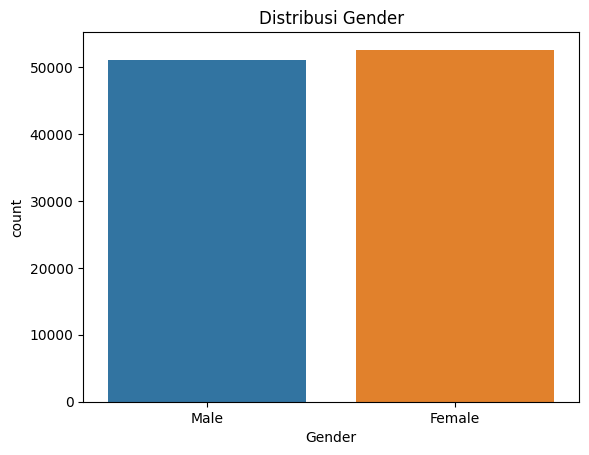

In [28]:
sns.countplot(x ='Gender', data = df_copy_1)
plt.title("Distribusi Gender")
plt.show()

In [29]:
print((df_copy_1['Gender'].value_counts()/len(df_copy_1['Gender']))*100)

Female    50.751974
Male      49.248026
Name: Gender, dtype: float64


### Ilustrasi Customer Type dengan Bar Chart

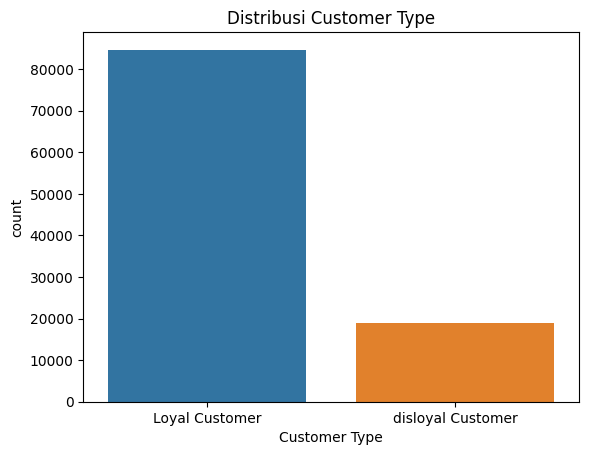

In [31]:
sns.countplot(x ='Customer Type', data = df_copy_1)
plt.title("Distribusi Customer Type")
plt.show()

In [32]:
print((df_copy_1['Customer Type'].value_counts()/len(df_copy_1['Customer Type']))*100)

Loyal Customer       81.72481
disloyal Customer    18.27519
Name: Customer Type, dtype: float64


### Ilustrasi Age dengan Box Plot

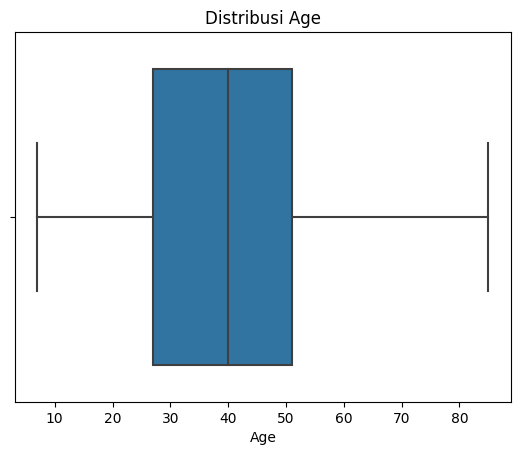

In [33]:
sns.boxplot(x ='Age', data = df_copy_1)
plt.title("Distribusi Age")
plt.show()

### Ilustrasi Type of Travel 

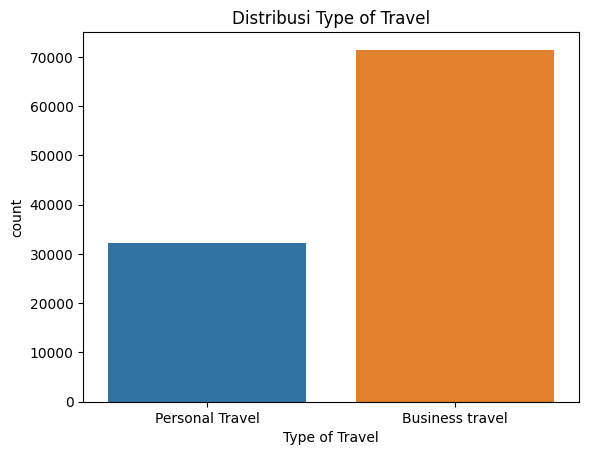

In [34]:
sns.countplot(x ='Type of Travel', data = df_copy_1)
plt.title("Distribusi Type of Travel")
plt.show()

In [35]:
print((df_copy_1['Type of Travel'].value_counts()/len(df_copy_1['Type of Travel']))*100)


Business travel    68.985656
Personal Travel    31.014344
Name: Type of Travel, dtype: float64


### Ilustrasi Class dengan Bar Chart

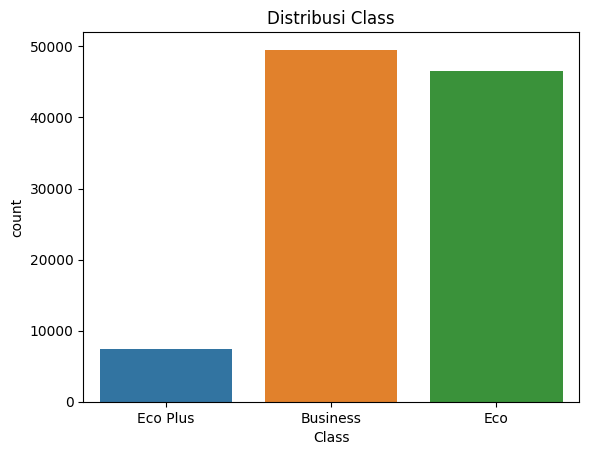

In [36]:
sns.countplot(x ='Class', data = df_copy_1)
plt.title("Distribusi Class")
plt.show()

In [37]:
print((df_copy_1['Class'].value_counts()/len(df_copy_1['Class']))*100)

Business    47.814545
Eco         44.976543
Eco Plus     7.208912
Name: Class, dtype: float64


### Ilustrasi Flight Distance dengan Box Plot

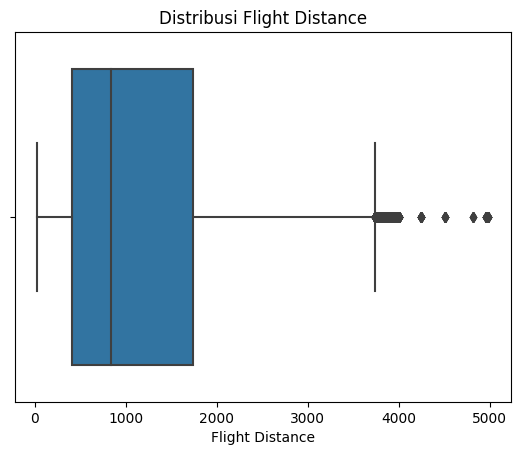

In [38]:
sns.boxplot(x ='Flight Distance', data = df_copy_1)
plt.title("Distribusi Flight Distance")
plt.show()

### Ilustrasi Inflight wifi service dengan Bar Chart

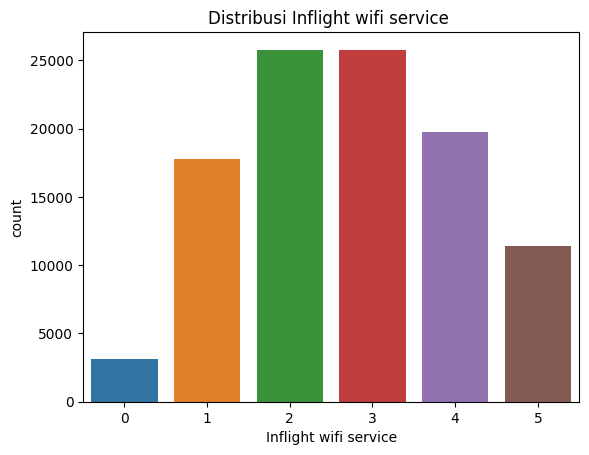

In [39]:
sns.countplot(x ='Inflight wifi service', data = df_copy_1)
plt.title("Distribusi Inflight wifi service ")
plt.show()

In [40]:
print((df_copy_1['Inflight wifi service'].value_counts()/len(df_copy_1['Inflight wifi service']))*100)

3    24.894299
2    24.861478
4    19.052262
1    17.164121
5    11.039249
0     2.988590
Name: Inflight wifi service, dtype: float64


### Ilustrasi Departure/Arrival time dengan Bar Chart

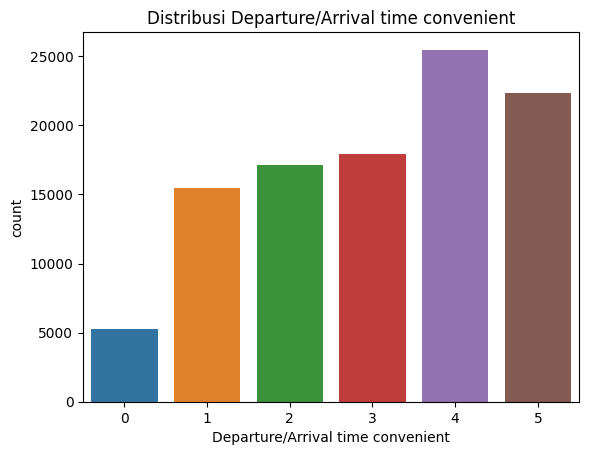

In [41]:
sns.countplot(x ='Departure/Arrival time convenient', data = df_copy_1)
plt.title("Distribusi Departure/Arrival time convenient")
plt.show()

In [42]:
print((df_copy_1['Departure/Arrival time convenient'].value_counts()/len(df_copy_1['Departure/Arrival time convenient']))*100)

4    24.590227
5    21.558198
3    17.281889
2    16.547290
1    14.915922
0     5.106473
Name: Departure/Arrival time convenient, dtype: float64


### Ilustrasi Ease of Online booking dengan Bar Chart

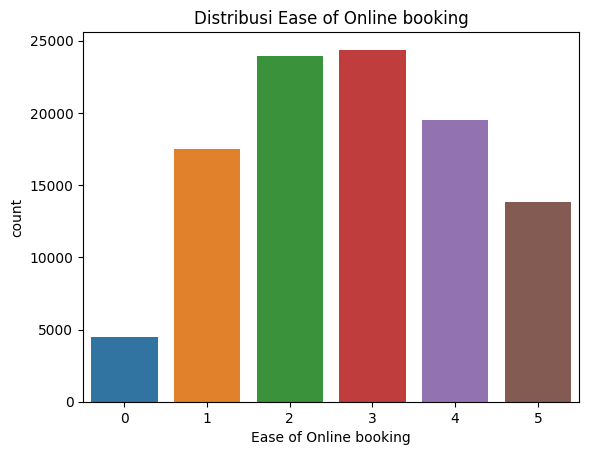

In [43]:
sns.countplot(x ='Ease of Online booking', data = df_copy_1)
plt.title("Distribusi Ease of Online booking")
plt.show()

In [44]:
print((df_copy_1['Ease of Online booking'].value_counts()/len(df_copy_1['Ease of Online booking']))*100)

3    23.524528
2    23.130683
4    18.831206
1    16.860050
5    13.335714
0     4.317818
Name: Ease of Online booking, dtype: float64


### Ilustrasi Food and drink dengan Bar Chart

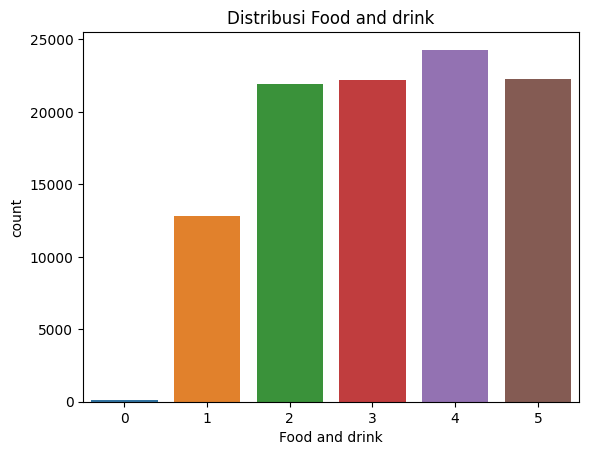

In [45]:
sns.countplot(x ='Food and drink', data = df_copy_1)
plt.title("Distribusi Food and drink")
plt.show()

In [46]:
print((df_copy_1['Food and drink'].value_counts()/len(df_copy_1['Food and drink']))*100)

4    23.451165
5    21.467460
3    21.466494
2    21.157596
1    12.355928
0     0.101357
Name: Food and drink, dtype: float64


### Ilustrasi Online boarding dengan Bar Chart

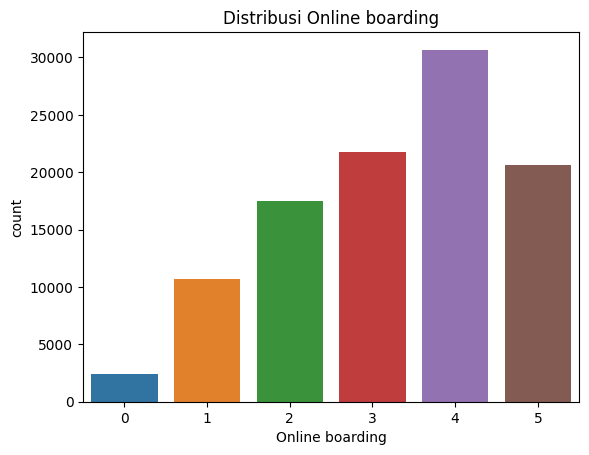

In [47]:
sns.countplot(x ='Online boarding', data = df_copy_1)
plt.title("Distribusi Online boarding")
plt.show()

In [48]:
print((df_copy_1['Online boarding'].value_counts()/len(df_copy_1['Online boarding']))*100)

4    29.606927
3    20.989633
5    19.935518
2    16.843640
1    10.288241
0     2.336043
Name: Online boarding, dtype: float64


### Ilustrasi Seat comfort dengan Bar Chart

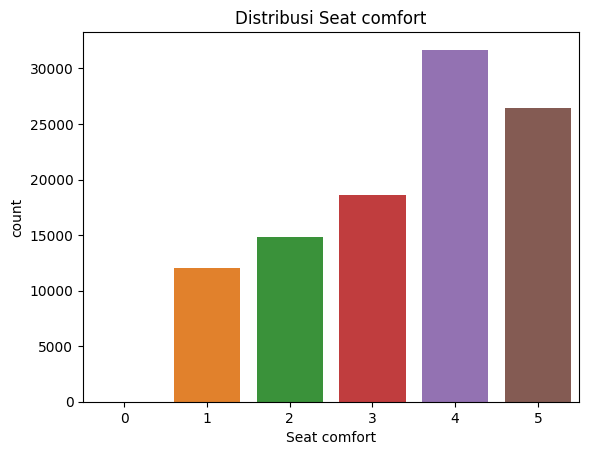

In [49]:
sns.countplot(x ='Seat comfort', data = df_copy_1)
plt.title("Distribusi Seat comfort")
plt.show()

In [50]:
print((df_copy_1['Seat comfort'].value_counts()/len(df_copy_1['Seat comfort']))*100)

4    30.582852
5    25.477344
3    17.994285
2    14.330946
1    11.613607
0     0.000965
Name: Seat comfort, dtype: float64


### Ilustrasi Inflight entertainment dengan Bar Chart

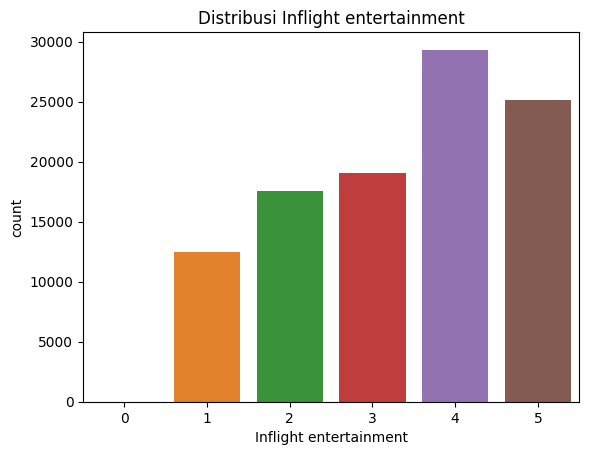

In [51]:
sns.countplot(x ='Inflight entertainment', data = df_copy_1)
plt.title("Distribusi Inflight entertainment")
plt.show()
 

In [52]:
print((df_copy_1['Inflight entertainment'].value_counts()/len(df_copy_1['Inflight entertainment']))*100)

4    28.317277
5    24.272641
3    18.418055
2    16.969129
1    12.009383
0     0.013514
Name: Inflight entertainment, dtype: float64


### Ilustrasi On-board service dengan Bar Chart

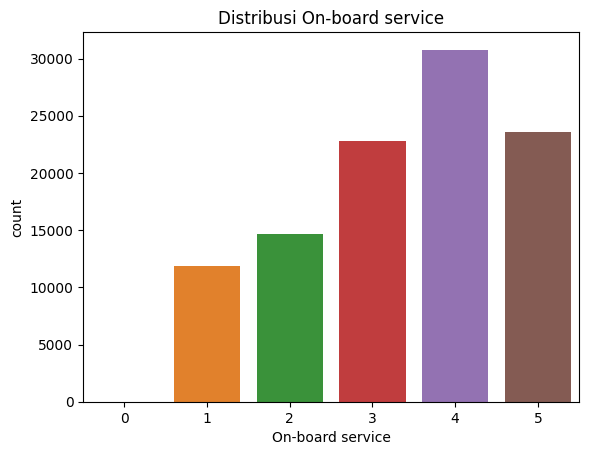

In [53]:
sns.countplot(x ='On-board service', data = df_copy_1)
plt.title("Distribusi On-board service")
plt.show()


In [54]:
print((df_copy_1['On-board service'].value_counts()/len(df_copy_1['On-board service']))*100)

4    29.705388
5    22.765797
3    21.980037
2    14.124370
1    11.421511
0     0.002896
Name: On-board service, dtype: float64


### Ilustrasi Departure/Arrival dengan Bar Chart

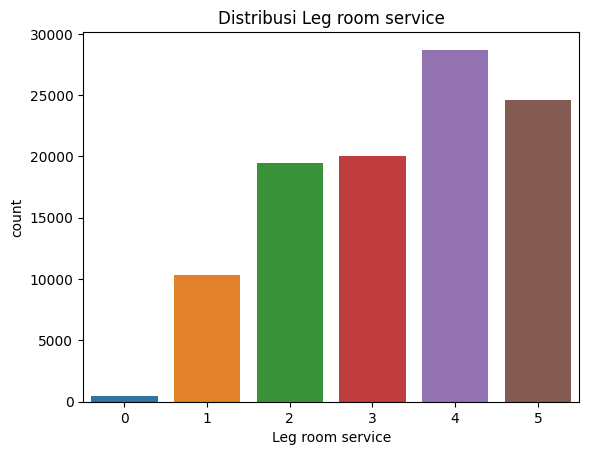

In [55]:
sns.countplot(x ='Leg room service', data = df_copy_1)
plt.title("Distribusi Leg room service")
plt.show()


In [56]:
print((df_copy_1['Leg room service'].value_counts()/len(df_copy_1['Leg room service']))*100)

4    27.708168
5    23.745584
3    19.346680
2    18.793559
1     9.952314
0     0.453694
Name: Leg room service, dtype: float64


### Ilustrasi Baggage handling dengan Bar Chart

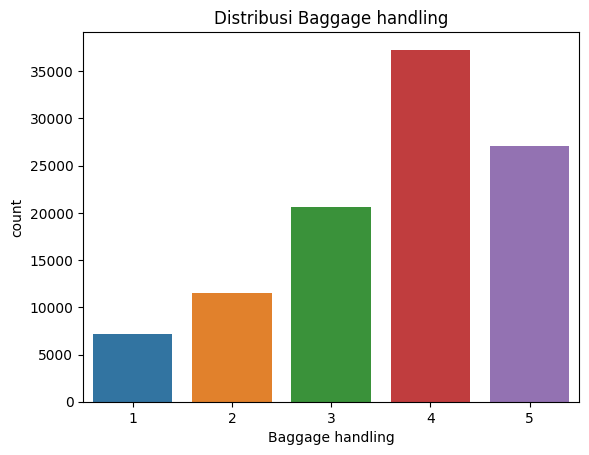

In [57]:
sns.countplot(x ='Baggage handling', data = df_copy_1)
plt.title("Distribusi Baggage handling")
plt.show()


In [58]:
print((df_copy_1['Baggage handling'].value_counts()/len(df_copy_1['Baggage handling']))*100)

4    35.980848
5    26.108655
3    19.853466
2    11.084619
1     6.972412
Name: Baggage handling, dtype: float64


### Ilustrasi Checkin service dengan Bar Chart

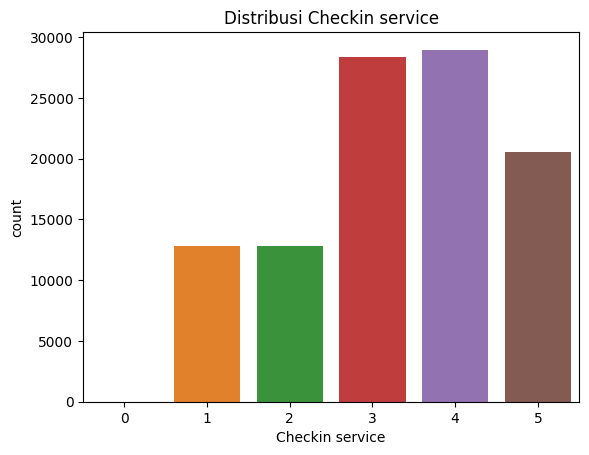

In [59]:
sns.countplot(x ='Checkin service', data = df_copy_1)
plt.title("Distribusi Checkin service")
plt.show()


In [60]:
print((df_copy_1['Checkin service'].value_counts()/len(df_copy_1['Checkin service']))*100)

4    27.969767
3    27.372242
5    19.842848
2    12.408055
1    12.406124
0     0.000965
Name: Checkin service, dtype: float64


### Ilustrasi Departure/Arrival dengan Bar Chart

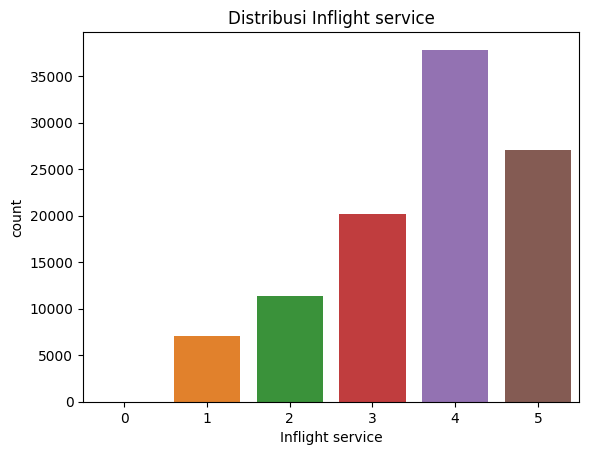

In [61]:
sns.countplot(x ='Inflight service', data = df_copy_1)
plt.title("Distribusi Inflight service")
plt.show()

In [62]:
print((df_copy_1['Inflight service'].value_counts()/len(df_copy_1['Inflight service']))*100)

4    36.533004
5    26.102863
3    19.525262
2    11.018013
1     6.817962
0     0.002896
Name: Inflight service, dtype: float64


### Ilustrasi Departure/Arrival dengan Bar Chart

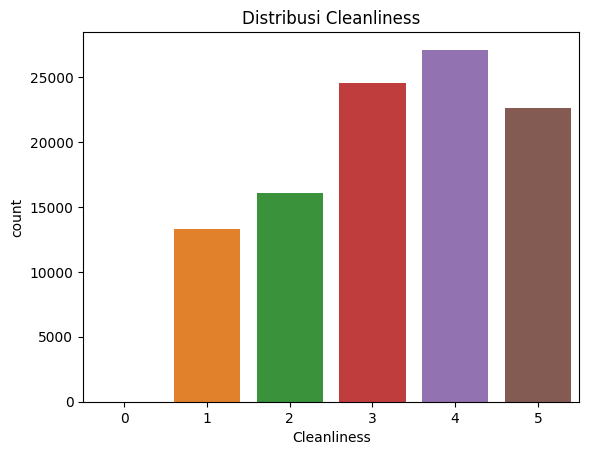

In [63]:
sns.countplot(x ='Cleanliness', data = df_copy_1)
plt.title("Distribusi Cleanliness")
plt.show()


In [64]:
print((df_copy_1['Cleanliness'].value_counts()/len(df_copy_1['Cleanliness']))*100)

4    26.159816
3    23.655810
5    21.834276
2    15.523100
1    12.815414
0     0.011584
Name: Cleanliness, dtype: float64


### Ilustrasi Departure Delay in Minutes dengan Bar Chart

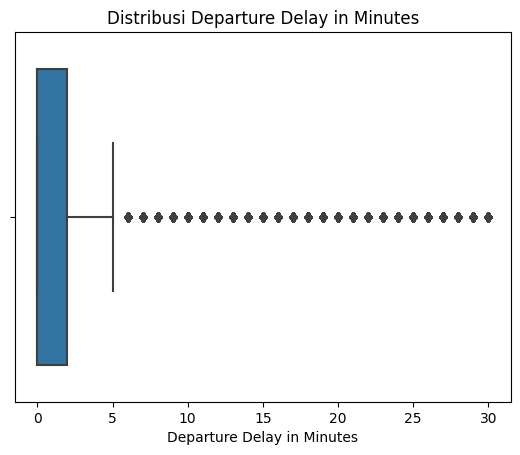

In [65]:
sns.boxplot(x ='Departure Delay in Minutes', data = df_copy_1)
plt.title("Distribusi Departure Delay in Minutes")
plt.show()

### Ilustrasi Departure/Arrival dengan Bar Chart

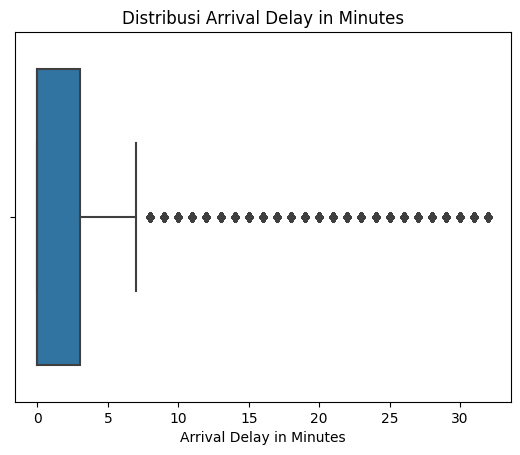

In [66]:
sns.boxplot(x ='Arrival Delay in Minutes', data = df_copy_1)
plt.title("Distribusi Arrival Delay in Minutes")
plt.show()

### Ilustrasi Departure/Arrival dengan Bar Chart

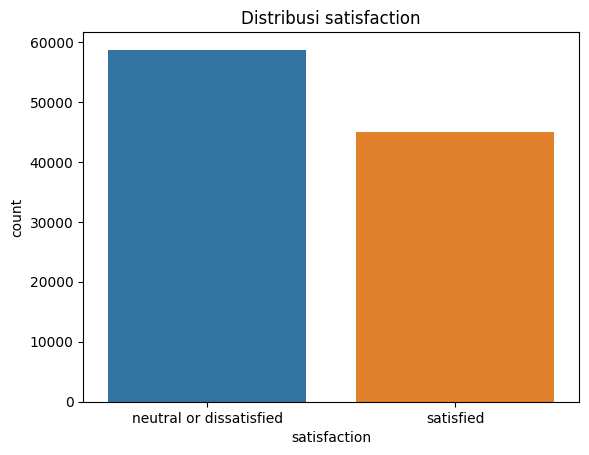

In [67]:
sns.countplot(x ='satisfaction', data = df_copy_1)
plt.title("Distribusi satisfaction")
plt.show()

In [68]:
print((df_copy_1['satisfaction'].value_counts()/len(df_copy_1['satisfaction']))*100)

neutral or dissatisfied    56.660617
satisfied                  43.339383
Name: satisfaction, dtype: float64


#### Ringkasan tentang sample data diatas:

- Untuk kolum gender, value kedua hampir se-imbang.
- Food and Drink, penumpang cukup puas dengan kualitas hidangan di dalam pesawat.
- Personal Travel peminat nya lebih kecil, Bussiness travel lebih banyak peminat.
- Kebanyakan yang memberi review adalah Customer loyal penerbangan tersebut.
- Fasilitas dan service lain mendapat review berbeda-beda. 

## Uji Statistik

Kita sudah menyelesaikan ilustrasi dataset diatas dan mendapat insight apa yang dibutuhakan untuk meningkatkan passenger satisfaction.

Selanjutnya kita melakukan uji statistik.

Sebelumnya kita sudah melakukan test korelasi, dan berikut dataset nya:

In [69]:
test = df_copy_1.copy()
test['satisfaction'] = test['satisfaction'].map({'neutral or dissatisfied':0,'satisfied':1})
test.corr()['satisfaction'].sort_values(ascending=False)

satisfaction                         1.000000
Online boarding                      0.503447
Inflight entertainment               0.398203
Seat comfort                         0.349112
On-board service                     0.322450
Leg room service                     0.313182
Cleanliness                          0.305050
Flight Distance                      0.298915
Inflight wifi service                0.284163
Baggage handling                     0.247819
Inflight service                     0.244852
Checkin service                      0.235914
Food and drink                       0.209659
Ease of Online booking               0.171507
Age                                  0.137040
Departure Delay in Minutes          -0.032533
Departure/Arrival time convenient   -0.051718
Arrival Delay in Minutes            -0.068845
Name: satisfaction, dtype: float64

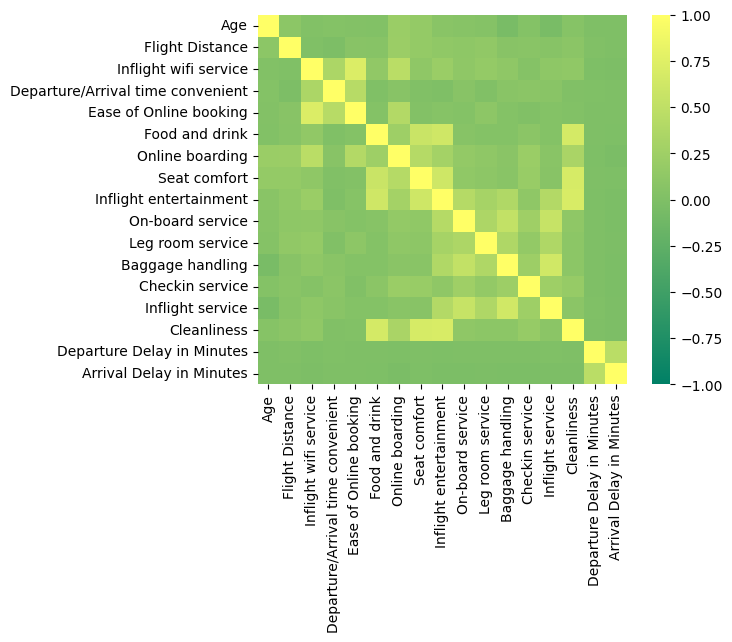

<Figure size 1500x1500 with 0 Axes>

In [79]:
corr = df_copy_1.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.color_palette("summer", as_cmap=True),
    square=True
)
fig = plt.figure(figsize=(15,15))
plt.show()

In [72]:
final_data = df_copy_1
display(final_data)

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Food and drink,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,5,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,1,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,5,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,2,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,4,...,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103899,Female,disloyal Customer,23,Business travel,Eco,192,2,1,2,2,...,2,3,1,4,2,3,2,3,0.0,neutral or dissatisfied
103900,Male,Loyal Customer,49,Business travel,Business,2347,4,4,4,2,...,5,5,5,5,5,5,4,0,0.0,satisfied
103901,Male,disloyal Customer,30,Business travel,Business,1995,1,1,1,4,...,4,3,2,4,5,5,4,7,14.0,neutral or dissatisfied
103902,Female,disloyal Customer,22,Business travel,Eco,1000,1,1,1,1,...,1,4,5,1,5,4,1,0,0.0,neutral or dissatisfied


In [73]:
passenger_satisfaction = final_data[['Age', 'Flight Distance', 'Inflight wifi service', 'Departure/Arrival time convenient', 'Ease of Online booking', 'Food and drink', 'Online boarding', 'Seat comfort', 'Inflight entertainment', 'On-board service', 'Leg room service', 'Baggage handling', 'Checkin service', 'Inflight service', 'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes']].corr()
passenger_satisfaction

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
Age,1.000000,0.099838,0.017470,0.038038,0.024461,0.022920,0.208681,0.160302,0.076380,0.057123,0.040498,-0.047619,0.035003,-0.049899,0.053493,-0.006616,-0.007132
Flight Distance,0.099838,1.000000,0.007050,-0.019908,0.065697,0.056957,0.215191,0.157517,0.128645,0.109540,0.133839,0.063222,0.073224,0.057430,0.093121,0.013688,-0.000872
Inflight wifi service,0.017470,0.007050,1.000000,0.343758,0.715848,0.134603,0.457002,0.122617,0.209513,0.121484,0.160485,0.121060,0.043178,0.110626,0.132652,-0.015103,-0.021705
Departure/Arrival time convenient,0.038038,-0.019908,0.343758,1.000000,0.437021,0.005189,0.069990,0.011416,-0.004683,0.068604,0.012461,0.071901,0.093329,0.073227,0.014337,0.000078,-0.000427
Ease of Online booking,0.024461,0.065697,0.715848,0.437021,1.000000,0.031940,0.404093,0.030021,0.047185,0.038759,0.107431,0.038851,0.010957,0.035330,0.016192,-0.002603,-0.004549
Food and drink,0.022920,0.056957,0.134603,0.005189,0.031940,1.000000,0.234492,0.574561,0.622374,0.058999,0.032415,0.034811,0.087055,0.034077,0.657648,-0.001499,-0.013803
Online boarding,0.208681,0.215191,0.457002,0.069990,0.404093,0.234492,1.000000,0.420067,0.285194,0.155345,0.123780,0.083299,0.204208,0.074390,0.331498,-0.013504,-0.031807
Seat comfort,0.160302,0.157517,0.122617,0.011416,0.030021,0.574561,0.420067,1.000000,0.610614,0.132030,0.105447,0.074553,0.191545,0.069193,0.678478,-0.002688,-0.014644
Inflight entertainment,0.076380,0.128645,0.209513,-0.004683,0.047185,0.622374,0.285194,0.610614,1.000000,0.420352,0.299850,0.378361,0.120812,0.405247,0.691735,-0.010413,-0.025452
On-board service,0.057123,0.109540,0.121484,0.068604,0.038759,0.058999,0.155345,0.132030,0.420352,1.000000,0.355657,0.519252,0.243852,0.550725,0.123236,-0.007245,-0.029202


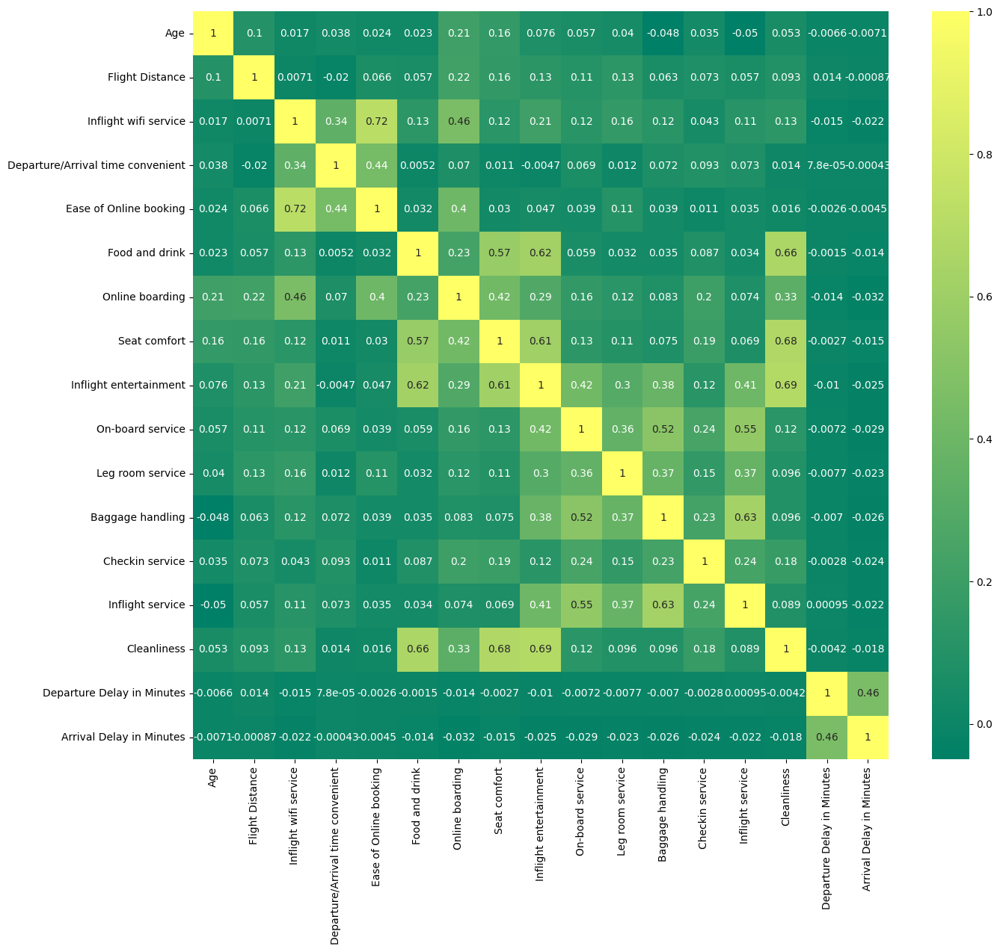

In [80]:
plt.figure(figsize= (15,13))
sns.heatmap(passenger_satisfaction, annot= True, cmap= "summer")
plt.show()

### Hasil heatmap di atas menunjukan:

- Adanya korelasi antara **Inflight wifi service** dan **Ease online booking**
- Adanya korelasi antara **On-board service** dan **Inflight service**
- Adanya korelasi antara **Cleanliness** dan **Inflight entertainment**
- Adanya korelasi antara **Inflight service** dan **Baggage handling**
- Adanya korelasi antara **Seat comfort** dan **Inflight entertainment**

## **Kesimpulan dan Rekomendasi**

Kita bisa membuat kesimpulan bahwa:

- Dari survery berjumlah 103.904 penumpang, penumpang wanita lebih banyak **50.7%** dari penumpang laki-laki **49.2%** 
- Mayoritas penumpang menilai food dan drink cukup tinggi, level kepuasaan dimulai dari level 3 sampai 5. Akan tetapi yang menilai dengan angka 2 cukup tinggi **21,1**

- Penumpang memberi nilai cukup tinggi untuk kebershihan atau **cleanliness** 
- Tingkat neutral or dissatisfied **56.7%** dan satisfied **43.3%**

- Online Booking mendapat hasil survey yang menengah, dengan mayoritas menilai dari angka **2 dan 3**
- Bisnis class paling diminati penumpang dengan nilai **47.8%** dan purpose of travelling juga di dominasi oleh Business travel **68.9%**
- Mayoritas yang mengisi survery ini adalah penumpang Loyal Customer **81.8%**












#### **Rekomendasi** 

- Hal-hal penting yang perlu di tingkakan jika ingin meningkatkan passenger satisfaction adalah :

        - Seat comfort
        - Leg room service
        - Online boarding
        - Inflight wifi service
        - Personal travel
        - kelas Eco 
        - Inflight entertainment 
        - disloyal Customer
        - Ease of Online booking

- Penumpang mimilih Business class karena ruang room seat lebih besar, oleh karena itu class eco-plus dan economy perlu di tingkatkan ruang room seat.

- Online booking perlu di tingkatkan agar penumpang lebih mudah untuk membeli tiket dan service lain yang berhubungan.

- Entertainment dan juga wifi service tetap perlu di tingktan, terutama penumpang dengan durasi flight lama.

- Kualitas makanan dan minuman tetap perlu ada peningkatan meskipun nilai kepuasaan nya cukup tinggi.